In [3]:
#imports
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
import os
import math
from moviepy.editor import VideoFileClip
from IPython.core.display import HTML

%matplotlib inline

import daslib




In [9]:
root_folder = "Z:/DAS/2021-11-30_Medidas"
dfn = "medida_211130_11_55_19.mat"
vfn = "medida_211130_11_55_19.mp4"

denv = daslib.DasEnviroment()

#combine path
dpath = os.path.join(root_folder, dfn)
vpath = os.path.join(root_folder, vfn)
#read mat file
das_np = daslib.load_das_mat(dpath)
s = das_np.T
print(s.shape)

(1160, 16000)


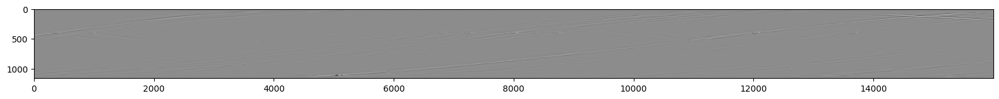

In [11]:
#plot s as colormap with an high contrast cmap
plt.figure(figsize=(20,10))
plt.imshow(s, cmap='gray')
plt.show()

In [7]:
clip = VideoFileClip(vpath)
clip.ipython_display(width=500, maxduration=100000)


Moviepy - Building video __temp__.mp4.
Moviepy - Writing video __temp__.mp4



Moviepy - Done !
Moviepy - video ready __temp__.mp4


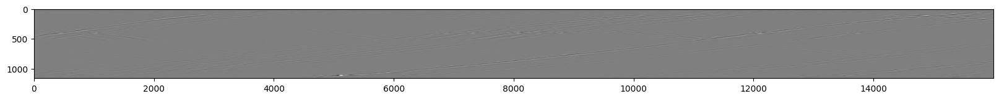

In [18]:
#filter s in 0.5 to 2 hz
s_filt = daslib.Processing1D.bandpass_filter(s, 0.5, 2, 200, order=2)

#plot s as colormap with an high contrast cmap
plt.figure(figsize=(20,10))
plt.imshow(s_filt, cmap='gray')
plt.show()



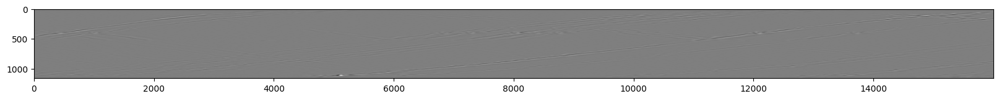

True

In [23]:
#normalize s_filt signal to 8 bits signal called sf8
sf8 = (s_filt - s_filt.min()) / (s_filt.max() - s_filt.min()) * 255
sf8 = sf8.astype(np.uint8)

#plot sf8
plt.figure(figsize=(20,10))
plt.imshow(sf8, cmap='gray')
plt.show()

#save sf8 as image
cv2.imwrite("sf8.png", sf8)







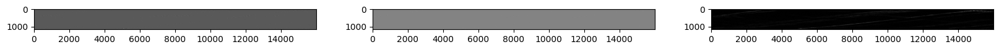

In [24]:
#apply sobel filter to sf8
sobelx = cv2.Sobel(sf8,cv2.CV_64F,1,0,ksize=5)
sobely = cv2.Sobel(sf8,cv2.CV_64F,0,1,ksize=5)
sobel = np.sqrt(sobelx**2 + sobely**2)

#plot sobel

plt.figure(figsize=(20,10))

plt.subplot(1,3,1)
plt.imshow(sobelx, cmap='gray')
plt.subplot(1,3,2)

plt.imshow(sobely, cmap='gray')

plt.subplot(1,3,3)
plt.imshow(sobel, cmap='gray')

plt.show()


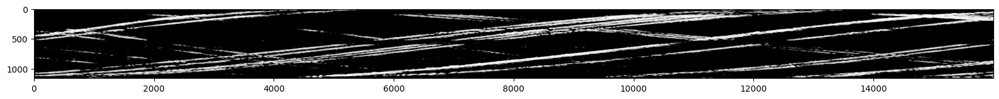

True

In [29]:
#threshold sobel
ret,thresh = cv2.threshold(sobel,100,255,cv2.THRESH_BINARY)

#plot threshold image
plt.figure(figsize=(20,10))
plt.imshow(thresh, cmap='gray')
plt.show()

#save threshold image
cv2.imwrite("thresh.png", thresh)


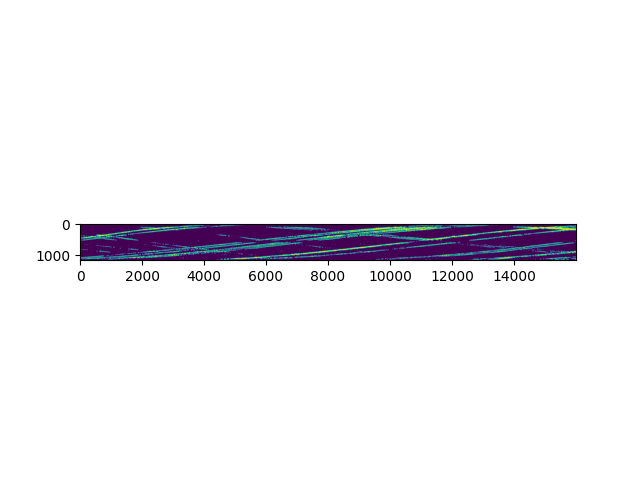

6064.016129032259 373.0483870967755
5386.596774193549 663.3709677419365
5644.661290322581 276.2741935483882
5225.306451612903 469.8225806451628
2967.2419354838707 437.564516129034
5031.758064516129 469.8225806451628
12289.822580645161 566.5967741935492
406.5976591884596 66.62774901544299
521.4274989681094 1042.2320386424917
2243.2189950902566 885.1767332529715
527.2443621306843 1036.4151754799168
585.4129937564326 361.65904862123784
1649.898952507625 245.3217853697413
1649.898952507625 239.5049222071666
1172.9161731764898 390.74336443411187
1574.279731394152 518.7143540107579
684.2996675202044 262.7723748574658
1076.2287802023357 668.7775347641491
978.6721705298146 622.1200257903347
978.6721705298146 622.1200257903347
974.4305788049223 622.1200257903347
734.0766181985865 496.95288450431997
4059.856652949245 930.3827824240009
2332.3465861321297 1029.502212487278
6198.004358599937 1043.6621310677463
9695.504247975574 689.6641665560421


In [34]:
%matplotlib widget
ax = plt.gca()
fig = plt.gcf()
implot = ax.imshow(thresh)

def onclick(event):
    if event.xdata != None and event.ydata != None:
        print(event.xdata, event.ydata)
cid = implot.figure.canvas.mpl_connect('button_press_event', onclick)

plt.show()